**Importing the Required Modules**

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import matplotlib.pyplot as plt

from sklearn.preprocessing import OrdinalEncoder
from sklearn.preprocessing import FunctionTransformer, RobustScaler

from sklearn.compose import ColumnTransformer, make_column_transformer
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.pipeline import Pipeline, make_pipeline

from sklearn.metrics import adjusted_rand_score, adjusted_mutual_info_score

from sklearn.model_selection import train_test_split

from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

from sklearn.cluster import AgglomerativeClustering

from umap import UMAP
import scipy
import optuna

pd.set_option("display.max_rows", 20)
pd.set_option("display.max_columns", 20)
pd.set_option("display.precision", 4)
pd.set_option("plotting.backend", "matplotlib")

from google.colab import drive
drive.mount('/drive')

import warnings
warnings.filterwarnings("ignore")

Drive already mounted at /drive; to attempt to forcibly remount, call drive.mount("/drive", force_remount=True).


**Freeze Random State**

In [2]:
np.random.seed(35)

**Utility Functions**

In [3]:
def to_ref_labels(c_labels, y_true):
   to_ref = {}
   for i in range(len(np.unique(c_labels))):
       index = np.where(c_labels == i,1,0)
       num = np.bincount(y_true[index==1]).argmax()
       to_ref[i] = num
   return to_ref

def get_dataset_part(df, part_sz=.2):
   df["model"] = df["model"] -1
   _, out_df = train_test_split(df, test_size=part_sz,  stratify=df[["model"]])
   y = out_df["model"].values.ravel()
   #анонимизиуем данные
   dropped_lst = ["machineID", 'datetime', 'RULWeek', \
                            'failure', 'failed', 'RUL', 'RUL_I', "model" ]
   out_df.drop(dropped_lst, axis=1, inplace=True)
   return out_df, y

**Plotting Functions**

In [4]:
def plot_embeddings(embeddings, y, feature_name, fig_sz=(16, 12)):
  embedings = [[0,1], [2,1], [0,2],
               [0,3], [3,1], [3,2]]

  fig, axs = plt.subplots(nrows=2, ncols=3, figsize=fig_sz)

  for idx in range(0, 3):
    embed_1 = embedings[idx]
    embed_2 = embedings[idx+3]

    scatter_1 =\
          axs[0,idx].scatter(embeddings[:, embed_1[0]], embeddings[:, embed_1[1]], c=y,
            label=y, s = 12, cmap = 'tab10', alpha = 0.8,  facecolors = 'none')

    scatter_2 =\
          axs[1,idx].scatter(embeddings[:, embed_2[0]], embeddings[:, embed_2[1]], c=y,
              label=y, s = 12, cmap = 'tab10', alpha = 0.8,  facecolors = 'none')

    axs[0, idx].set_ylabel(f"embeddings {embed_1[1]}", fontsize = 20)
    axs[0, idx].set_xlabel(f"embeddings {embed_1[0]}", fontsize = 20)

    axs[1, idx].set_ylabel(f"embeddings {embed_2[1]}", fontsize = 20)
    axs[1, idx].set_xlabel(f"embeddings {embed_2[0]}", fontsize = 20)

    axs[0, idx].tick_params(axis='x', labelsize= 15)
    axs[0, idx].tick_params(axis='y', labelsize= 15)
    axs[0, idx].grid()

    axs[1, idx].tick_params(axis='x', labelsize= 15)
    axs[1, idx].tick_params(axis='y', labelsize= 15)
    axs[1, idx].grid()

    legend1 = axs[0, idx].legend(*scatter_1.legend_elements(), loc="upper right",
                           title=feature_name, fontsize = 15)
    axs[0, idx].add_artist(legend1)

    legend2 = axs[1, idx].legend(*scatter_1.legend_elements(), loc="upper right",
                           title=feature_name, fontsize = 15)
    axs[1, idx].add_artist(legend2)
  plt.tight_layout()


**Installing the Required Modules**

In [5]:
!pip install optuna
!pip install umap-learn

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


# **I. Goal**

Цель нашей работы будет используя методы кластеризации и сокращения размерности предсказать метки моделей оборудования как если бы у нас был бы полноценный классификатор.

# **II. Approaches and Limitations**

Кластерам в данных в наборе https://www.kaggle.com/datasets/tiagotgoz/predictive-useful-life-based-into-telemetry  могут соотвтествовать:


*   нормальный режим работы/выход из строя оборудования
*   модель оборудования с которого снимаются измерения
*   узел оборудования находящийся на обслуживании

Для всех возможных кандидатов в кластера количество кластеров известно. Количество примеров для первого и третьего кандидатов на роль кластеров в данных относительно мало поэтому будем пытаться выполнить кластеризацию по моделям оборудования. Так как данные в наборе разнородны и набор данных относительно сложен для классификации будем использовать “сильно нелинейный” метод сокращения размерности   **UMAP** к
его достоинствам можно отнести:

*   возможность использования его для формирования эмбеддингов для  метрического обучения
*   контролируемое сокращения размерности путем использования полной или частичной информации информации о целевых метках

Для кластеризации будем использовать **AgglomerativeClustering** обеспечивающего приемлемое время работы кластеризации в Google Collab

# **1. Data Transformers**

## **1.1 Datatime Transformers**

In [6]:
def sin_transformer(period):
    return FunctionTransformer(lambda x: np.sin(x / period * 2 * np.pi))

def cos_transformer(period):
    return FunctionTransformer(lambda x: np.cos(x / period * 2 * np.pi))

## **1.2 Utility Transformers**

In [7]:
def identy_transformer():
  return FunctionTransformer(lambda x: x)

## **1.3 Full Dataset Transformer**

In [8]:
transform = make_column_transformer(
   (sin_transformer(365), ["time_in_cycles"]),
   (cos_transformer(365), ["time_in_cycles"]),
   (RobustScaler(),
     ["voltmean_24h","rotatemean_24h","pressuremean_24h",
      "vibrationmean_24h", "voltsd_24h", "rotatesd_24h",
      "pressuresd_24h", "vibrationsd_24h", "voltmean_5d", "rotatemean_5d",
      "pressuremean_5d", "vibrationmean_5d", "voltsd_5d", "rotatesd_5d",
      "pressuresd_5d","vibrationsd_5d", "volts_entropy", "volts_benford",
      "volts_cidce", "volts_lzc", "press_max", "press_below", "press_above",
      "press_entropy", "press_benford", "press_cidce", "press_lzc",
      "vibra_max", "vibra_below", "vibra_above", "vibra_entropy",
      "vibra_benford", "vibra_cidce", "vibra_lzc", "rotate_max", "rotate_below",
      "rotate_above", "rotate_entropy", "rotate_benford", "rotate_cidce",
       "rotate_lzc","volts_max", "volts_below", "volts_above", "DI", "age"
      ]),
   (identy_transformer(), ["error1", "error2","error3", "error4", "error5",
                           "comp1", "comp2", "comp3", "comp4"]))

# **2. Dataset Clustering**

## **2.1 Clustering Objective**

Вместо того, чтобы крутить “ручку настройки” параметров кластеризации вручную будем использовать для этого optuna в качестве score функции будем брать  среднее из Adjusted Mutual Information Between two Clustering и Rand Index Adjusted for Chance

In [9]:
class ClusteringObjective:

    def __init__(self, n_clusters, X, y):
      self.X = X
      self.y = y
      self.n_clusters = n_clusters

    def __call__(self, trial):
       params = {
            "metric": trial.suggest_categorical(
            "metric", ["euclidean", "l1", "l2", "manhattan", "cosine"]),
            "linkage": trial.suggest_categorical(
                  "linkage", ["complete", "average", "single"])}

       clustering = Pipeline(steps=[("transform", transform),
                 ("cluster", AgglomerativeClustering(**params,
                                                     n_clusters=self.n_clusters))])
       clustering.fit(self.X)
       labels = clustering["cluster"].labels_
       score = \
            (adjusted_rand_score(self.y, labels) +
             adjusted_mutual_info_score(self.y, labels))/2.0

       return score

## **2.2 Clustering without Dimensions Reduction**

In [10]:
import optuna

TRAIN_PATH = "/drive/My Drive/rul/train_telemetry.csv"
train_df = pd.read_csv(TRAIN_PATH)

#так как размер исходного набора довольно большой
#для выполнения в Google Colab будем работать с небольшой его частью ~2k примеров

X_train, y = get_dataset_part(train_df, .1)

clustering = Pipeline(steps=[("transform", transform),
                                   ("cluster", AgglomerativeClustering(n_clusters=4))])
clustering.fit(X_train)

c_labels = clustering["cluster"].labels_

rand_score = adjusted_rand_score(y, c_labels),
mutal_info_score  = adjusted_mutual_info_score(y, c_labels)

print(f"clustering scores: {(rand_score, mutal_info_score)}")

clustering scores: ((0.006323258899173672,), 0.0012662363508215819)


Как видно алгоритм кластеризации совсем не понимает, что ему необходимо в наборе данных найти. Попробуем настроить некоторые гиперпараметры кластеризации

In [11]:
objective = ClusteringObjective(4, X_train, y)
study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=40)

params = study.best_trial.params

clustering = Pipeline(steps=[("transform", transform),
                            ("cluster", AgglomerativeClustering(**params, n_clusters=4))])
clustering.fit(X_train)
labels = clustering["cluster"].labels_

rand_score = adjusted_rand_score(y, labels),
mutal_info_score  = adjusted_mutual_info_score(y, labels)
print(f"clustering scores: {(rand_score, mutal_info_score)}")

[I 2023-06-19 11:11:32,888] A new study created in memory with name: no-name-b98e402e-3781-4088-b897-5f9a4418be5d
[I 2023-06-19 11:11:33,481] Trial 0 finished with value: 0.000330779058323005 and parameters: {'metric': 'l2', 'linkage': 'complete'}. Best is trial 0 with value: 0.000330779058323005.
[I 2023-06-19 11:11:33,950] Trial 1 finished with value: 3.684379910204618e-05 and parameters: {'metric': 'manhattan', 'linkage': 'single'}. Best is trial 0 with value: 0.000330779058323005.
[I 2023-06-19 11:11:34,335] Trial 2 finished with value: 0.0001380334278397431 and parameters: {'metric': 'euclidean', 'linkage': 'average'}. Best is trial 0 with value: 0.000330779058323005.
[I 2023-06-19 11:11:34,649] Trial 3 finished with value: 0.006843119696841285 and parameters: {'metric': 'cosine', 'linkage': 'average'}. Best is trial 3 with value: 0.006843119696841285.
[I 2023-06-19 11:11:34,864] Trial 4 finished with value: 0.000330779058323005 and parameters: {'metric': 'euclidean', 'linkage': '

clustering scores: ((0.009583706589894955,), 0.004102532803787615)


Оптимизация гиперпараметров совсем не помогает кластеризации

## **2.3 UMAP Controlled Dimensions Reduction**

Опять же мы не будем  крутить “ручку настройки” параметров алгоритма редукции размерности и хотя UMAP позволяет выполнить контролируемое снижение параметров в supervised и semi-supervised режиме такое контролируемое снижение размерности не обязательно будет оптимальным. Поэтому определим целевую и скор  функции как описано здесь: https://qiita.com/maskot1977/items/31079c132e3fea3332a5

In [12]:
class SupervisedUMAP:
    def __init__(self, X, Y, scorer):
        self.X = X
        self.Y = Y
        self.scorer = scorer
        self.best_score = 1e53
        self.best_model = None

    def __call__(self, trial):
        n_neighbors = trial.suggest_int("n_neighbors", 30, 500)
        min_dist = trial.suggest_uniform("min_dist", 0.0, 0.99)
        n_components = trial.suggest_int("n_components", 10, 30)
        metric = trial.suggest_categorical("metric",
                ["euclidean", "manhattan", "chebyshev", "minkowski", "canberra",
               "braycurtis", "mahalanobis", "cosine", "correlation"])

        mapper = UMAP(
            n_neighbors=n_neighbors,
            min_dist=min_dist,
            n_components=n_components,
            metric=metric
            )
        mapper.fit(self.X)
        embeddings = mapper.transform(self.X)
        score = self.scorer(scipy.stats.zscore(embeddings), self.Y)

        if self.best_score > score:
            self.best_score = score
            self.best_model = mapper

        plot_embeddings(embeddings, self.Y, "model")

        return score

## **2.4 Custom UMAP Score Function**

In [13]:
def classification_scorer(X, Y, alpha=1e-53):
    sum = 0
    n1 = 0
    for x1, y1 in zip(X, Y):
        n1 += 1
        n2 = 0
        for x2, y2 in zip(X, Y):
            n2 += 1
            if n1 > n2:
                dist = ((x1[0] - x2[0])**2 + (x1[1] - x2[1])**2) + alpha
                if y1 != y2:
                    sum += 1 / dist
                else:
                    pass

    return sum / (len(Y) * (len(Y) - 1) / 2)

## **2.5 UMAP Supervised Dimensions Reduction**

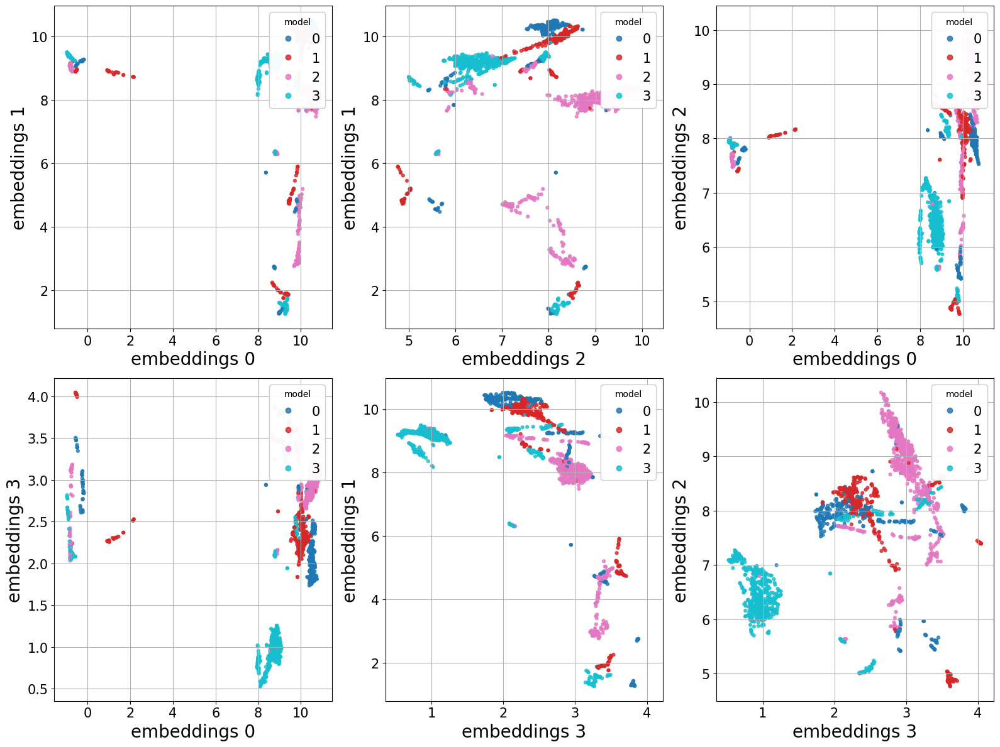

In [14]:
X_transform = transform.fit_transform(X_train)
mapper = UMAP(n_components=23)
embeddings = mapper.fit_transform(X_transform, y=y)
plot_embeddings(embeddings, y, "model")

Проекции примеров из набора данных оформляются в отедельные кластеры

In [15]:
clustering = AgglomerativeClustering(n_clusters=4)
clustering.fit(embeddings)
c_labels = clustering.labels_

rand_score = adjusted_rand_score(y, c_labels),
mutal_info_score  = adjusted_mutual_info_score(y, c_labels)
print(f"clustering scores: {(rand_score, mutal_info_score)}")

clustering scores: ((0.5164206974552126,), 0.4970480942216348)


Как видим без получаем неплхой скор уже на дефолтных параметрах, посмотрим сможем ли мы его улучшить

<Figure size 1700x1200 with 0 Axes>

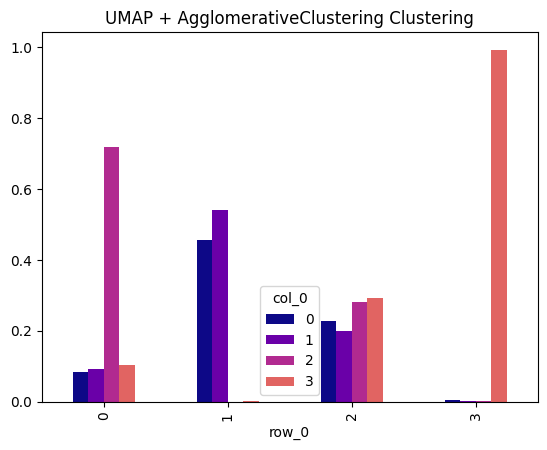

In [16]:
fig=plt.figure(figsize=(17,12))
color = plt.cm.plasma(np.linspace(0,1,6))
x = pd.crosstab(c_labels, y)
x.div(x.sum(1).astype(float),axis = 0).plot(kind = 'bar',color=color)
plt.title("UMAP + AgglomerativeClustering Clustering")
plt.show()

In [17]:
c2lables = to_ref_labels(c_labels, y)
y_pred=np.array([c2lables[c_label] for c_label in c_labels])
print(classification_report(y, y_pred))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00       308
           1       0.54      0.66      0.60       344
           2       0.72      0.92      0.81       660
           3       0.81      0.86      0.83       652

    accuracy                           0.71      1964
   macro avg       0.52      0.61      0.56      1964
weighted avg       0.60      0.71      0.65      1964



## **2.6 UMAP Dimensions Reduction Finetuning**

[I 2023-06-19 11:12:26,803] A new study created in memory with name: no-name-9e307281-0097-4398-a7da-7ba1ac34f60b
[I 2023-06-19 11:13:13,874] Trial 0 finished with value: 8.0677999052511 and parameters: {'n_neighbors': 206, 'min_dist': 0.13557307215346054, 'n_components': 10, 'metric': 'cosine'}. Best is trial 0 with value: 8.0677999052511.
[I 2023-06-19 11:13:58,183] Trial 1 finished with value: 5.910532180234367 and parameters: {'n_neighbors': 53, 'min_dist': 0.4232604402745911, 'n_components': 24, 'metric': 'cosine'}. Best is trial 1 with value: 5.910532180234367.
[I 2023-06-19 11:14:27,839] Trial 2 finished with value: 6.486843635989344 and parameters: {'n_neighbors': 46, 'min_dist': 0.7377062664794689, 'n_components': 14, 'metric': 'manhattan'}. Best is trial 1 with value: 5.910532180234367.
[I 2023-06-19 11:15:06,392] Trial 3 finished with value: 4.766941617814983 and parameters: {'n_neighbors': 346, 'min_dist': 0.19940159640953375, 'n_components': 14, 'metric': 'manhattan'}. Bes

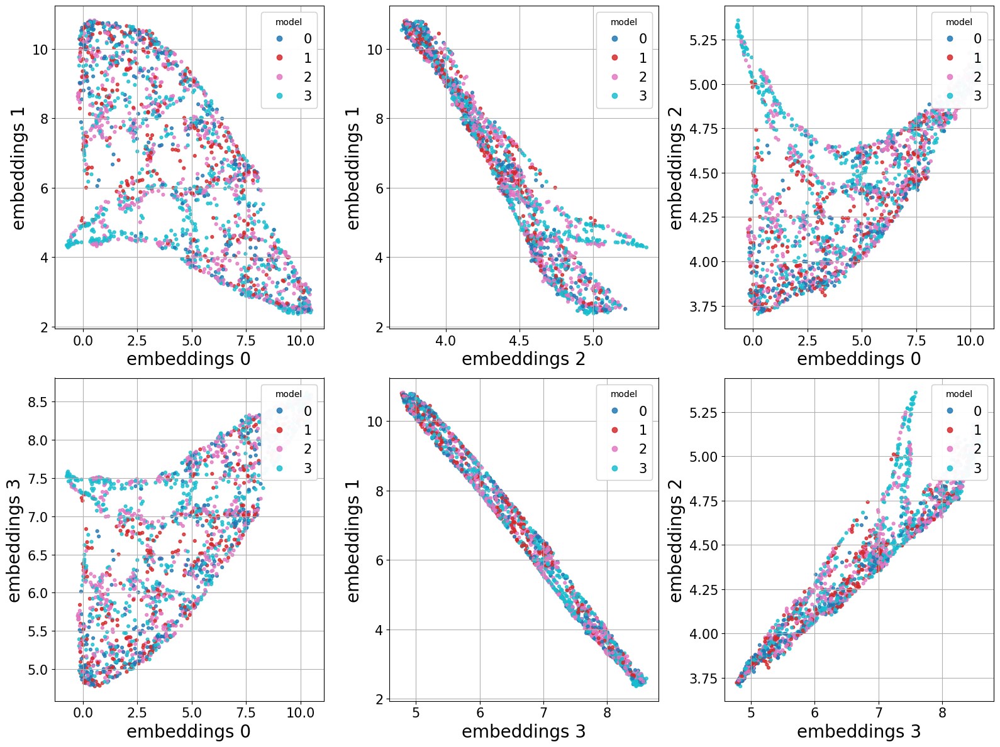

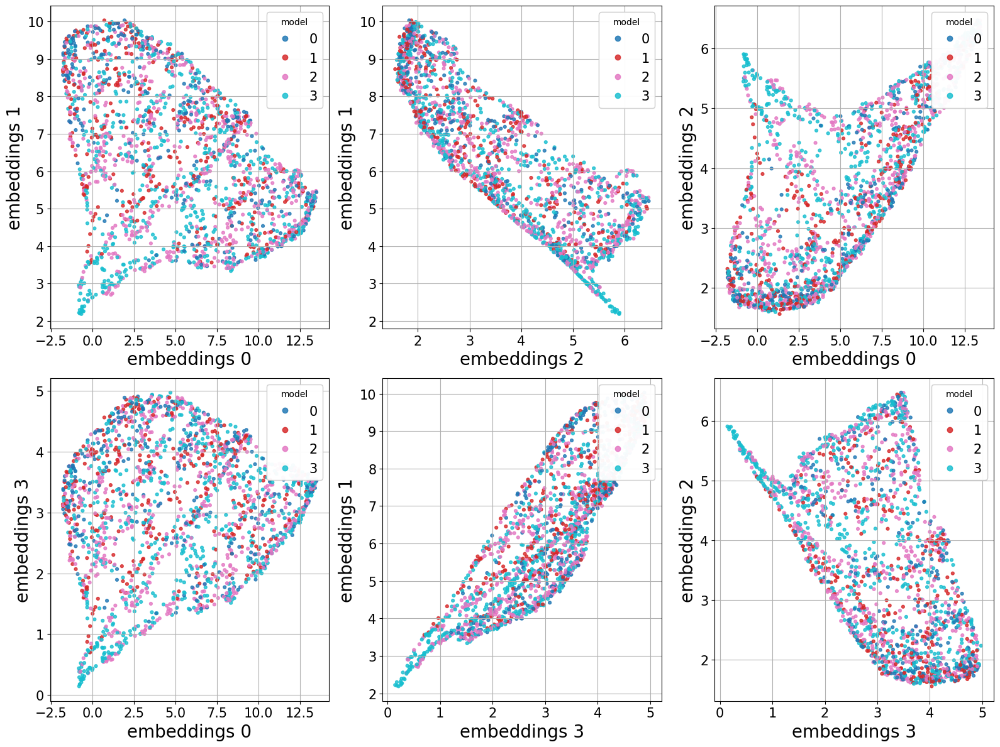

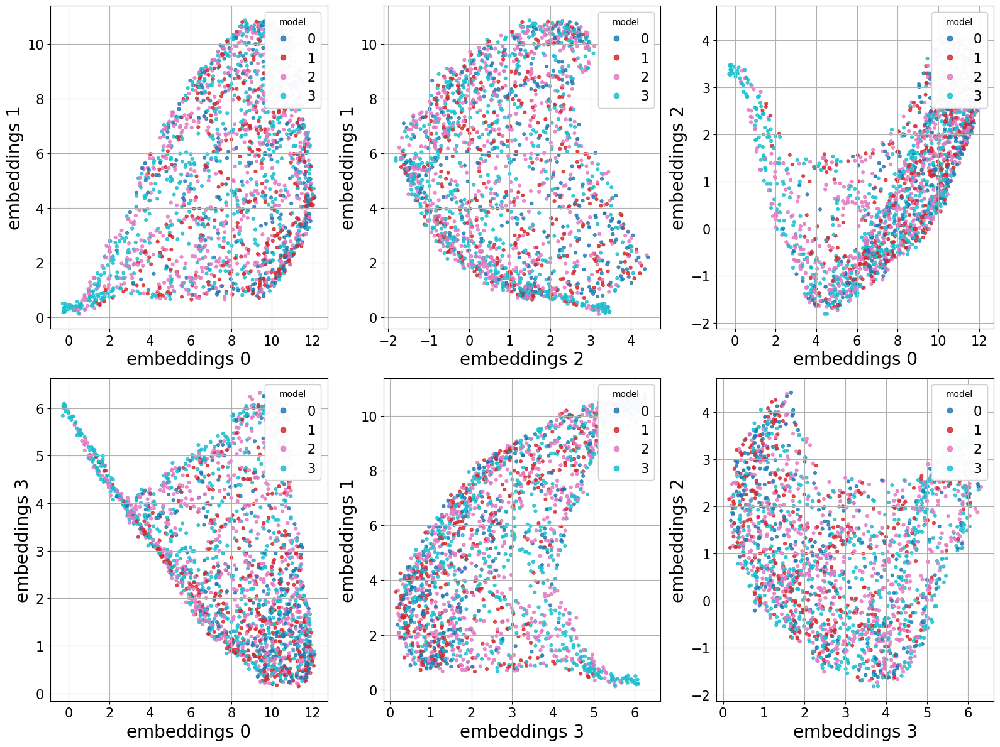

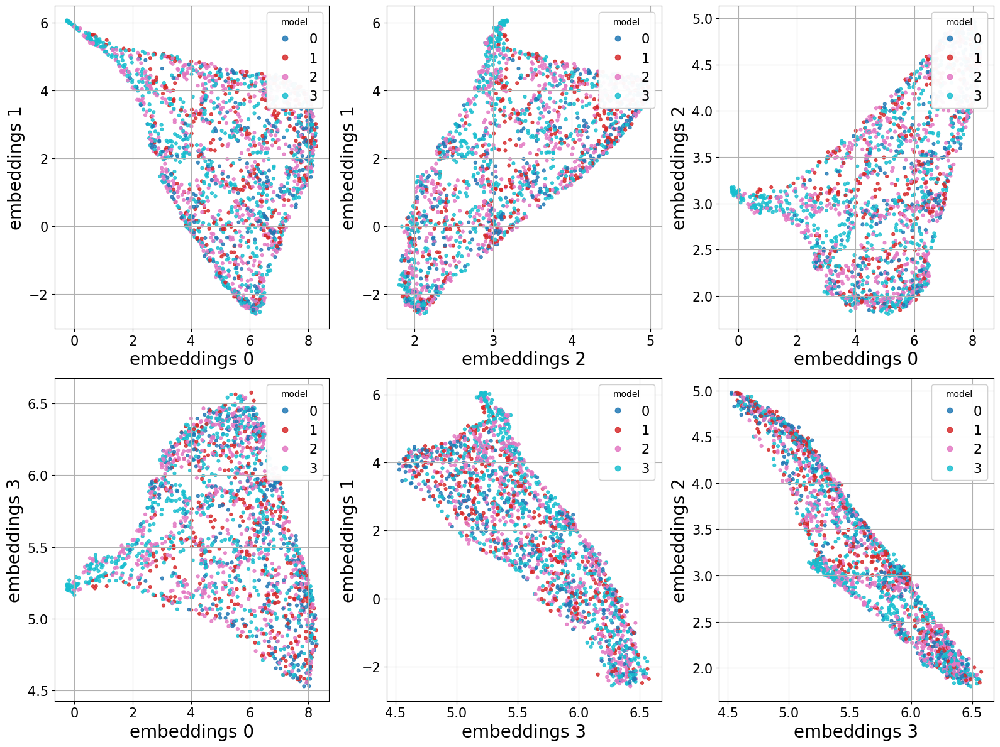

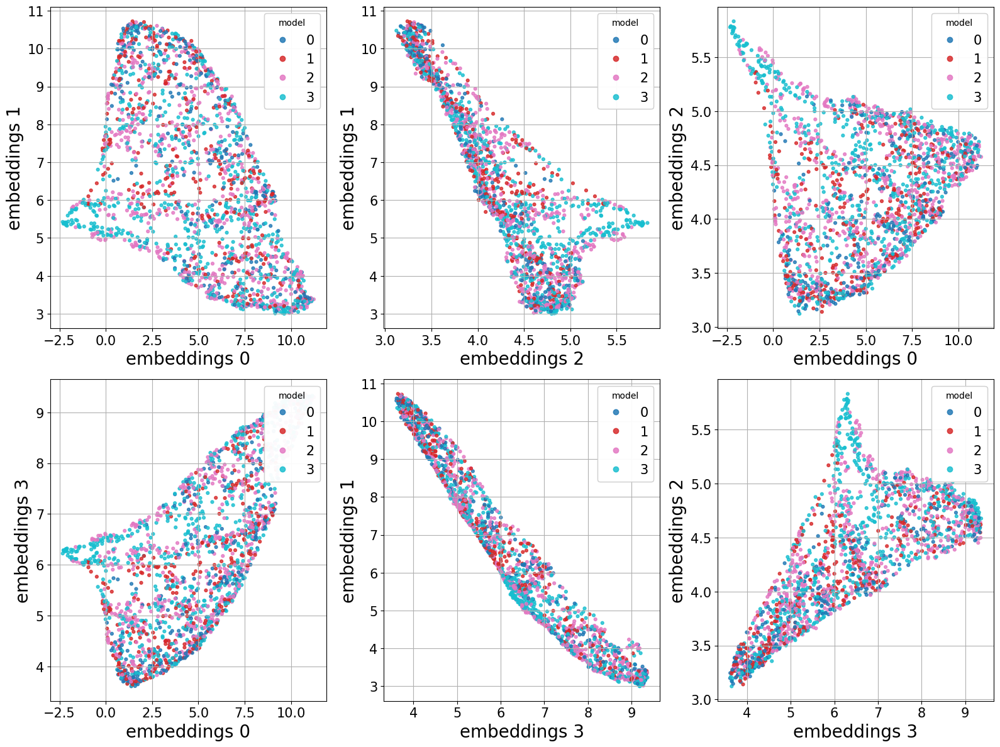

...

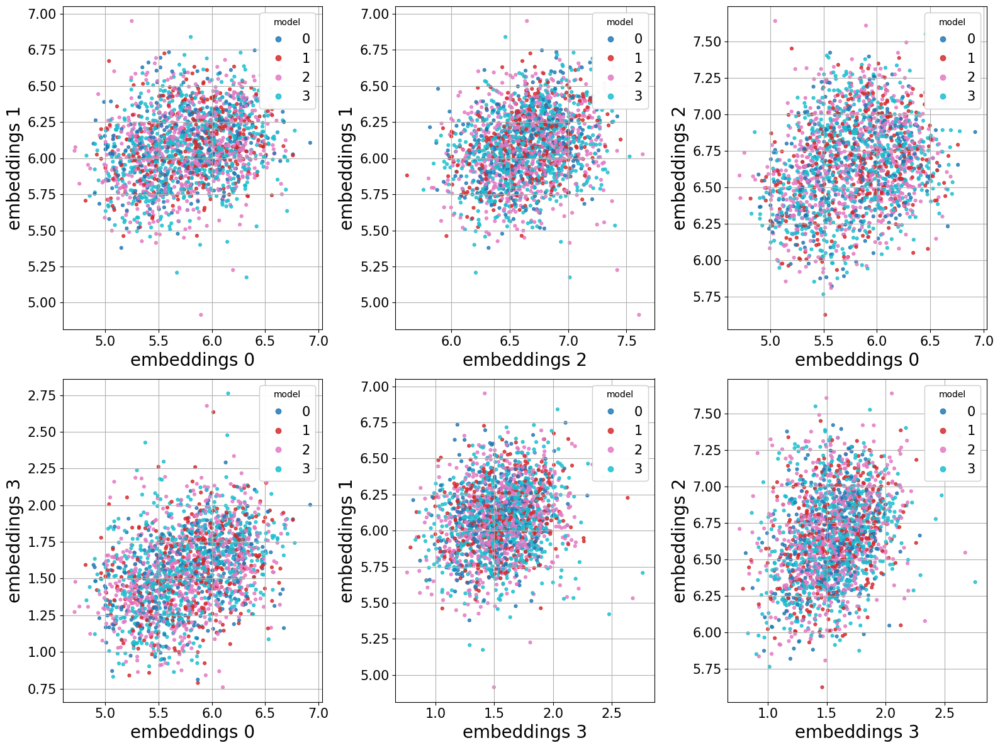

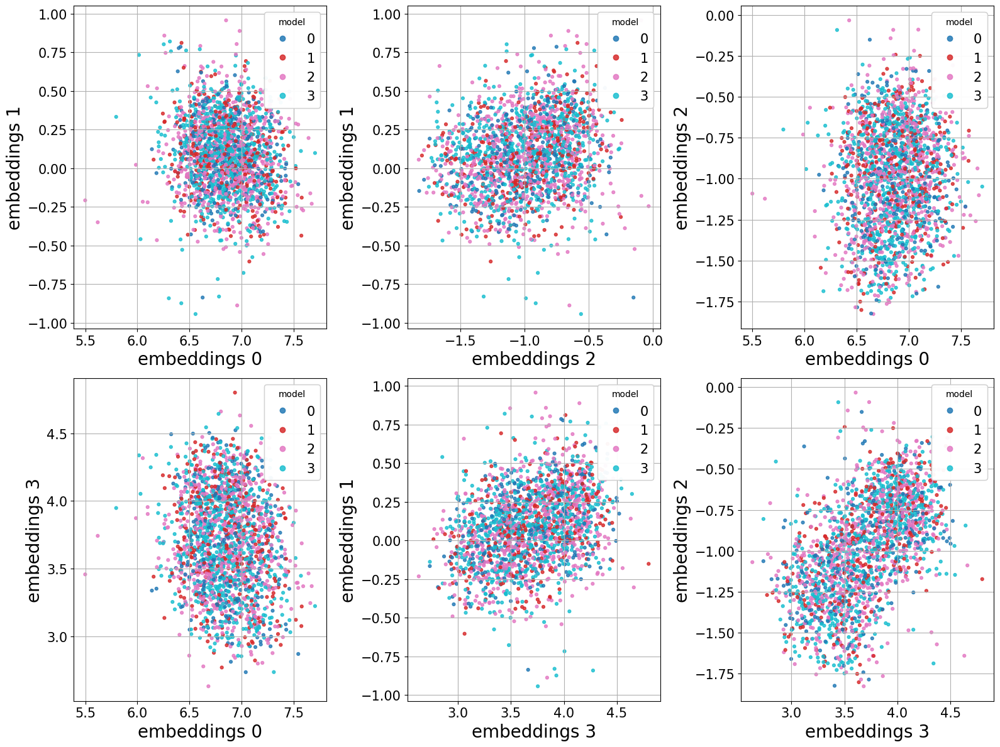

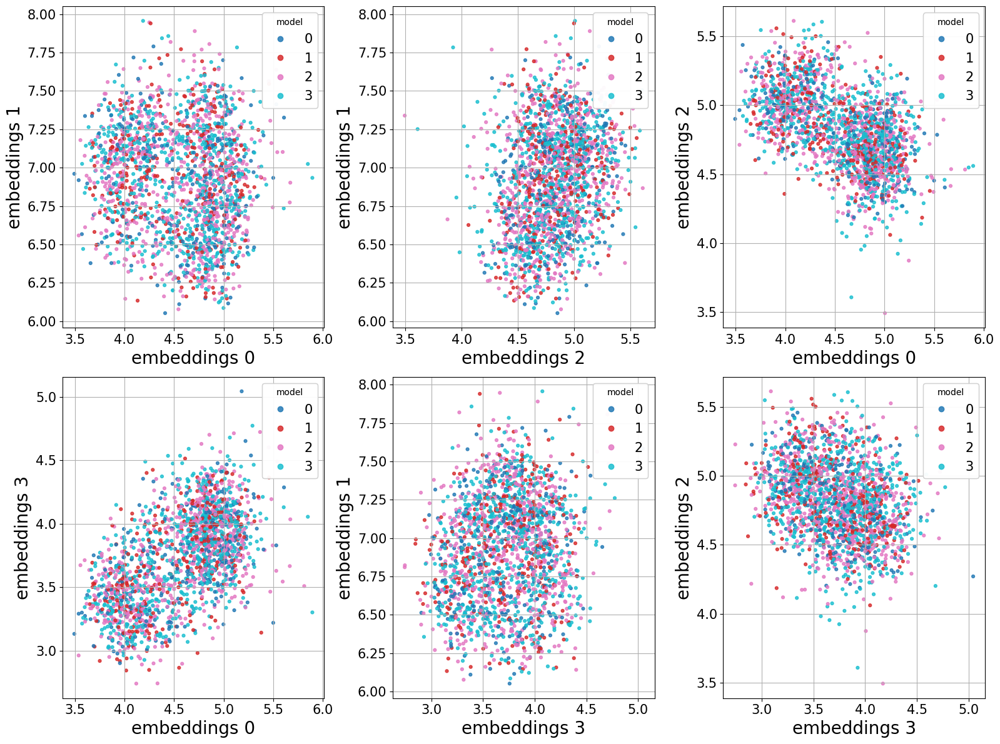

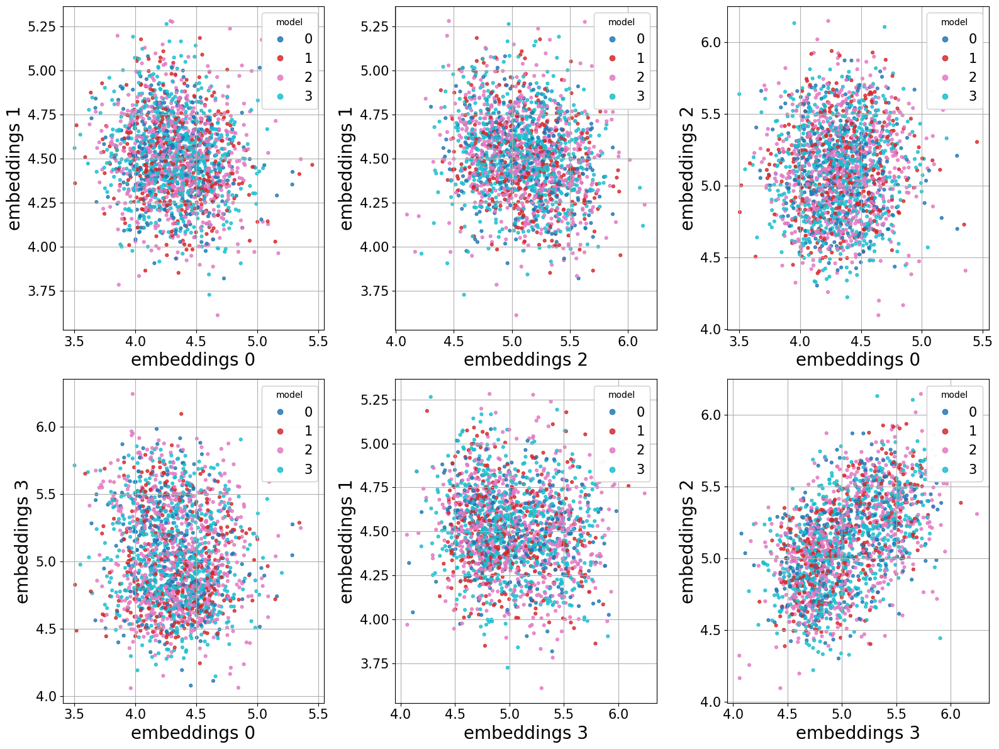

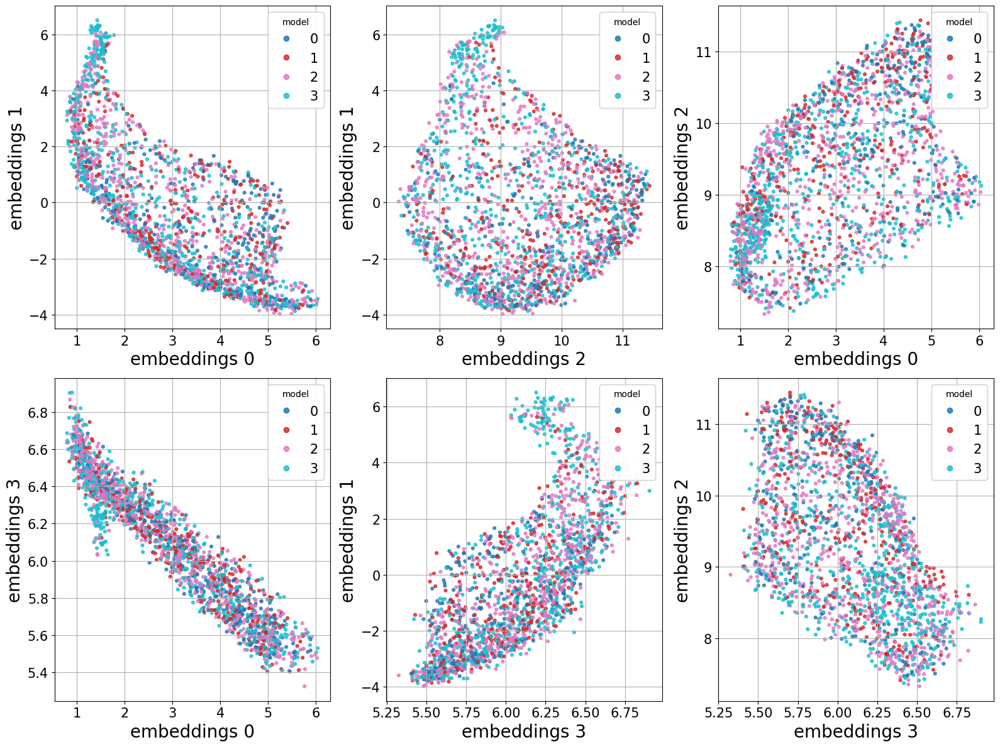

In [18]:
objective = SupervisedUMAP(X_train, y, classification_scorer)
study = optuna.create_study(direction="minimize")
study.optimize(objective, n_trials=15)
params = study.best_trial.params

## **2.7 UMAP Supervised Dimensions Reduction**

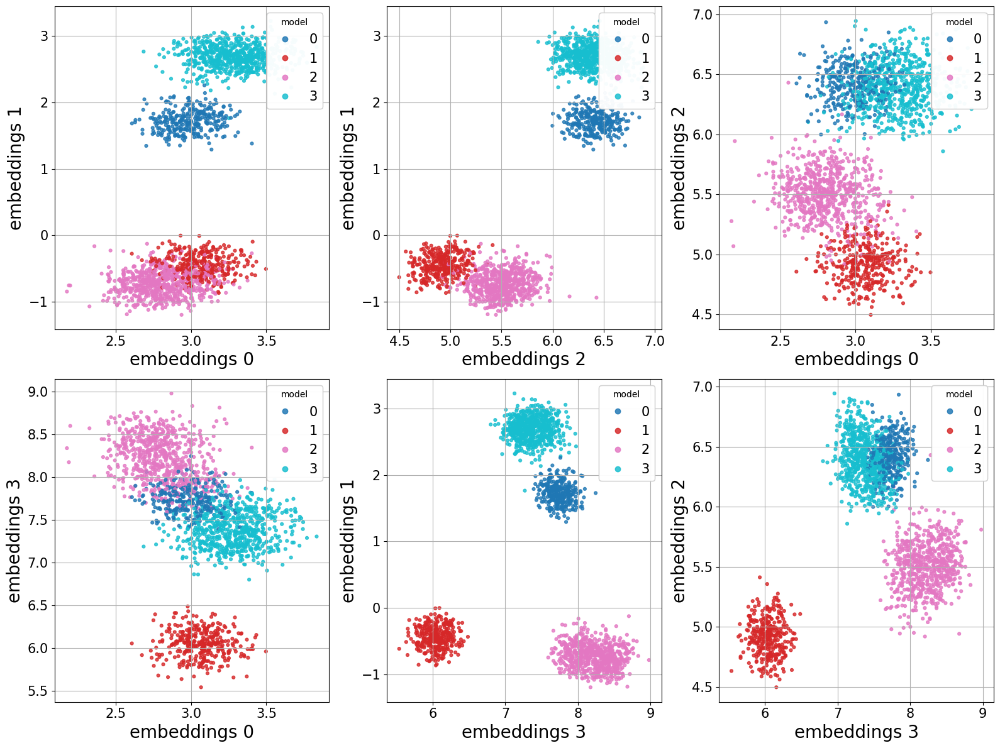

In [20]:
X_transform = transform.fit_transform(X_train)
mapper = UMAP(**params)
embeddings = mapper.fit_transform(X_transform, y=y)
plot_embeddings(embeddings, y, "model")

Как видно с оптимальными параметрами данные хорошо разделимы в пространстве

In [21]:
clustering = AgglomerativeClustering(n_clusters=4)
clustering.fit(embeddings)
c_labels = clustering.labels_

rand_score = adjusted_rand_score(y, c_labels),
mutal_info_score  = adjusted_mutual_info_score(y, c_labels)
print(f"clustering scores: {(rand_score, mutal_info_score)}")

clustering scores: ((1.0,), 1.0)


<Figure size 1700x1200 with 0 Axes>

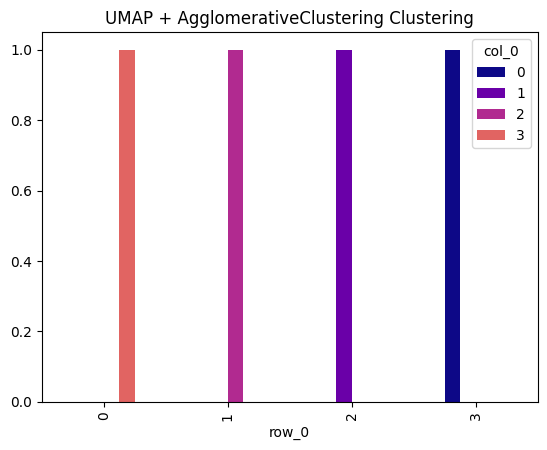

In [22]:
fig=plt.figure(figsize=(17,12))
color = plt.cm.plasma(np.linspace(0,1,6))
x = pd.crosstab(c_labels, y)
x.div(x.sum(1).astype(float),axis = 0).plot(kind = 'bar',color=color)
plt.title("UMAP + AgglomerativeClustering Clustering")
plt.show()

Мы очень хорошо кластеризуем данные необходимо лишь переставить индексы

## **2.8 UMAP Semi-Supervised Dimensions Reduction**

In [29]:
def fill_partial(arr, perc=.2):
    n = arr.size
    num_elements_to_set = int(perc * n)
    indices = np.random.choice(n, num_elements_to_set, replace=False)
    arr.flat[indices] = -1
    return arr

Предположим, что только часть целевых меток нам доступна

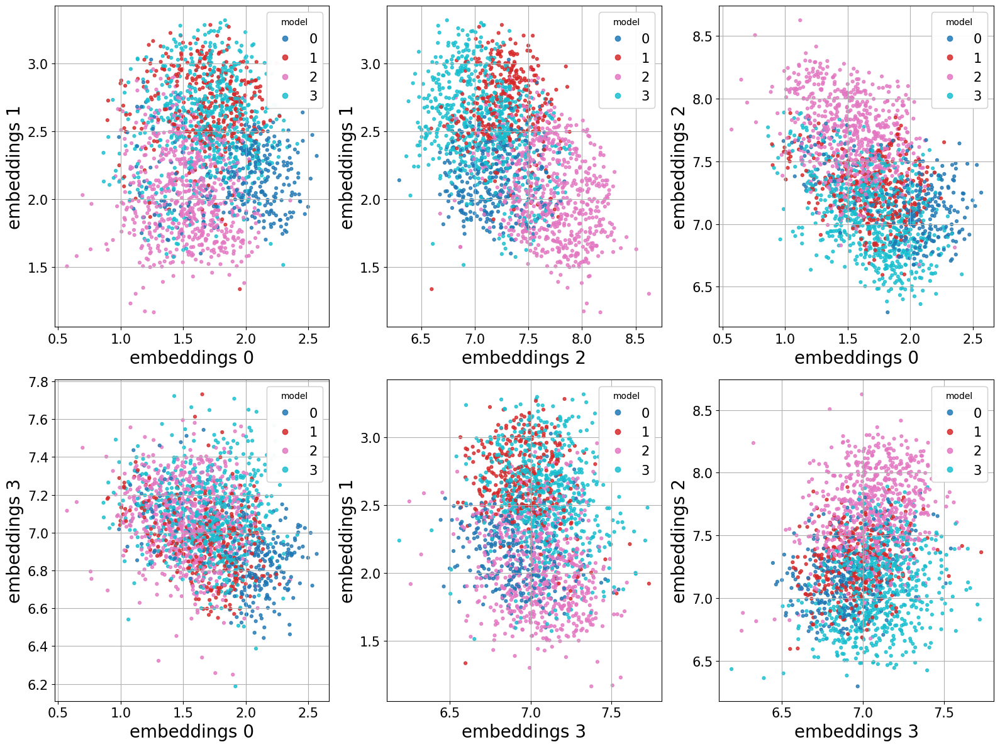

In [30]:
X_transform = transform.fit_transform(X_train)
y_p = fill_partial(y.copy())
mapper = UMAP(**params)
embeddings = mapper.fit_transform(X_transform, y=y_p)
plot_embeddings(embeddings, y, "model")

Теперь данные уже не так хорошо разделимы в пространстве

In [31]:
clustering = AgglomerativeClustering(n_clusters=4)
clustering.fit(embeddings)
c_labels = clustering.labels_

rand_score = adjusted_rand_score(y, c_labels),
mutal_info_score  = adjusted_mutual_info_score(y, c_labels)
print(f"clustering scores: {(rand_score, mutal_info_score)}")

clustering scores: ((0.6094634383369797,), 0.6378205326227181)


<Figure size 1700x1200 with 0 Axes>

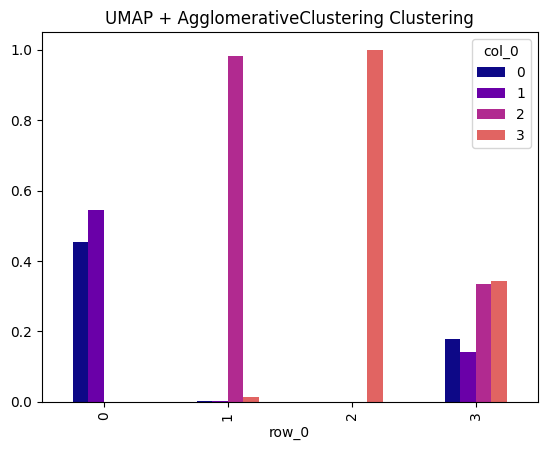

In [32]:
fig=plt.figure(figsize=(17,12))
color = plt.cm.plasma(np.linspace(0,1,6))
x = pd.crosstab(c_labels, y)
x.div(x.sum(1).astype(float),axis = 0).plot(kind = 'bar',color=color)
plt.title("UMAP + AgglomerativeClustering Clustering")
plt.show()

In [33]:
c2lables = to_ref_labels(c_labels, y)
y_pred=np.array([c2lables[c_label] for c_label in c_labels])
print(classification_report(y, y_pred))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00       308
           1       0.55      0.84      0.66       344
           2       0.98      0.81      0.89       660
           3       0.73      0.99      0.84       652

    accuracy                           0.75      1964
   macro avg       0.56      0.66      0.60      1964
weighted avg       0.67      0.75      0.69      1964



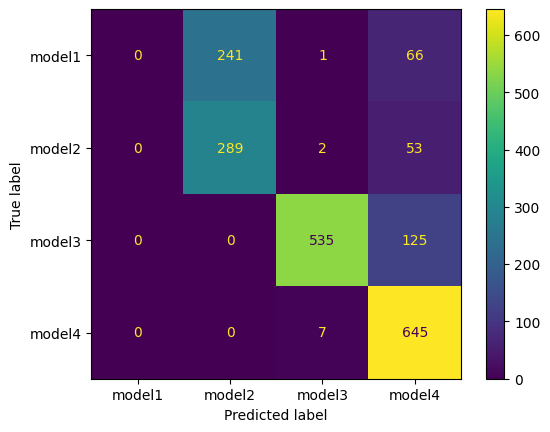

In [34]:
cls= ["model1", "model2", "model3", "model4"]
cm = confusion_matrix(y, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=cls)
disp.plot()

При частично размеченных данных у нас проблемы с model1 как в прочем и при обычной классификации